# Libraries

In [3]:
import itertools
import pandas as pd
import seaborn as sns
import numpy as np
import matplotlib.pyplot as plt
from sklearn.model_selection import train_test_split, StratifiedKFold, GridSearchCV
from sklearn.preprocessing import MinMaxScaler
from sklearn.neural_network import MLPClassifier
from sklearn.svm import SVC
from sklearn.tree import DecisionTreeClassifier
from sklearn.inspection import permutation_importance
from sklearn.metrics import recall_score, precision_score, f1_score, accuracy_score, roc_curve, auc, roc_auc_score
from imblearn.over_sampling import SMOTE
from pyfume.Clustering import Clusterer
from pyfume.EstimateAntecendentSet import AntecedentEstimator
from pyfume.EstimateConsequentParameters import ConsequentEstimator
from pyfume.SimpfulModelBuilder import SugenoFISBuilder
from pyfume.Tester import SugenoFISTester
from pyfume.FeatureSelection import FeatureSelector

# Main Project - Diagnosis of Alzheimer’s Disease

## Loading Data

In [4]:
the_data = pd.read_csv("alzheimers_disease_data.csv")
the_data.head()

,PatientID,Age,Gender,Ethnicity,EducationLevel,BMI,Smoking,AlcoholConsumption,PhysicalActivity,DietQuality,...,MemoryComplaints,BehavioralProblems,ADL,Confusion,Disorientation,PersonalityChanges,DifficultyCompletingTasks,Forgetfulness,Diagnosis,DoctorInCharge
0,4751,73,0,0,2,22.927749,0,13.297218,6.327112,1.347214,...,0,0,1.725883,0,0,0,1,0,0,XXXConfid
1,4752,89,0,0,0,26.827681,0,4.542524,7.619885,0.518767,...,0,0,2.592424,0,0,0,0,1,0,XXXConfid
2,4753,73,0,3,1,17.795882,0,19.555085,7.844988,1.826335,...,0,0,7.119548,0,1,0,1,0,0,XXXConfid
3,4754,74,1,0,1,33.800817,1,12.209266,8.428001,7.435604,...,0,1,6.481226,0,0,0,0,0,0,XXXConfid
4,4755,89,0,0,0,20.716974,0,18.454356,6.310461,0.795498,...,0,0,0.014691,0,0,1,1,0,0,XXXConfid


## Checking Data

In [5]:
the_data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 2149 entries, 0 to 2148
Data columns (total 35 columns):
 #   Column                     Non-Null Count  Dtype  
---  ------                     --------------  -----  
 0   PatientID                  2149 non-null   int64  
 1   Age                        2149 non-null   int64  
 2   Gender                     2149 non-null   int64  
 3   Ethnicity                  2149 non-null   int64  
 4   EducationLevel             2149 non-null   int64  
 5   BMI                        2149 non-null   float64
 6   Smoking                    2149 non-null   int64  
 7   AlcoholConsumption         2149 non-null   float64
 8   PhysicalActivity           2149 non-null   float64
 9   DietQuality                2149 non-null   float64
 10  SleepQuality               2149 non-null   float64
 11  FamilyHistoryAlzheimers    2149 non-null   int64  
 12  CardiovascularDisease      2149 non-null   int64  
 13  Diabetes                   2149 non-null   int64

In [6]:
the_data.describe(include = "all")

,PatientID,Age,Gender,Ethnicity,EducationLevel,BMI,Smoking,AlcoholConsumption,PhysicalActivity,DietQuality,...,MemoryComplaints,BehavioralProblems,ADL,Confusion,Disorientation,PersonalityChanges,DifficultyCompletingTasks,Forgetfulness,Diagnosis,DoctorInCharge
count,2149.000000,2149.000000,2149.000000,2149.000000,2149.000000,2149.000000,2149.000000,2149.000000,2149.000000,2149.000000,...,2149.000000,2149.000000,2149.000000,2149.000000,2149.000000,2149.000000,2149.000000,2149.000000,2149.000000,2149
unique,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,1
top,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,XXXConfid
freq,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,2149
mean,5825.000000,74.908795,0.506282,0.697534,1.286645,27.655697,0.288506,10.039442,4.920202,4.993138,...,0.208004,0.156817,4.982958,0.205212,0.158213,0.150768,0.158678,0.301536,0.353653,NaN
std,620.507185,8.990221,0.500077,0.996128,0.904527,7.217438,0.453173,5.757910,2.857191,2.909055,...,0.405974,0.363713,2.949775,0.403950,0.365026,0.357906,0.365461,0.459032,0.478214,NaN
min,4751.000000,60.000000,0.000000,0.000000,0.000000,15.008851,0.000000,0.002003,0.003616,0.009385,...,0.000000,0.000000,0.001288,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,NaN
25%,5288.000000,67.000000,0.000000,0.000000,1.000000,21.611408,0.000000,5.139810,2.570626,2.458455,...,0.000000,0.000000,2.342836,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,NaN
50%,5825.000000,75.000000,1.000000,0.000000,1.000000,27.823924,0.000000,9.934412,4.766424,5.076087,...,0.000000,0.000000,5.038973,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,NaN
75%,6362.000000,83.000000,1.000000,1.000000,2.000000,33.869778,1.000000,15.157931,7.427899,7.558625,...,0.000000,0.000000,7.581490,0.000000,0.000000,0.000000,0.000000,1.000000,1.000000,NaN


In [7]:
# Get rid of the columns that don't matter
the_data = the_data.drop(['PatientID', 'DoctorInCharge'], axis = 1)

## Exploratory Data Analysis (EDA)

### Positive Correlations

In [8]:
sns.pairplot(the_data)

### Targe Variable Count (Pie Chart)

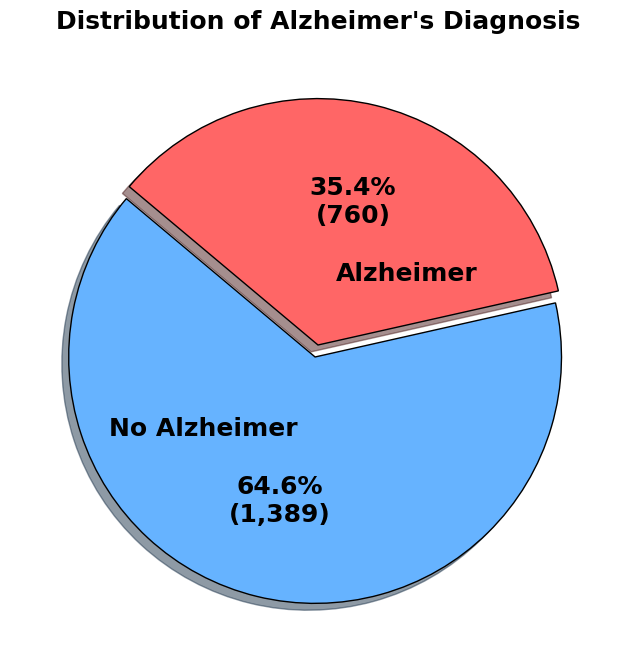

In [9]:
# Count occurrences in the 'Diagnosis' column
diagnosis_counts = the_data['Diagnosis'].value_counts()

# Labels for the pie chart, assuming 0 is 'No Alzheimer' and 1 is 'Alzheimer'
labels = ['No Alzheimer', 'Alzheimer']

# Colors for the pie slices
colors = ['#66b3ff', '#ff6666']

# Create the pie chart with enhancements
plt.figure(figsize=(10, 8))  # Adjusted figure size for better visibility
plt.pie(diagnosis_counts, labels=labels, colors=colors, 
        autopct=lambda p: f'{p:.1f}%\n({int(p * sum(diagnosis_counts) / 100):,})', 
        startangle=140, explode=[0.05, 0], shadow=True, 
        wedgeprops={'edgecolor': 'black'},
        labeldistance=0.3,  # Adjust label distance to place labels inside the pie
        textprops={'fontweight': 'bold', 'fontsize': 18})  # Make the text bold

# Add a title with enhanced formatting
plt.title("Distribution of Alzheimer's Diagnosis", fontsize=18, fontweight='bold')

# Display the pie chart
plt.show()

### Heatmap

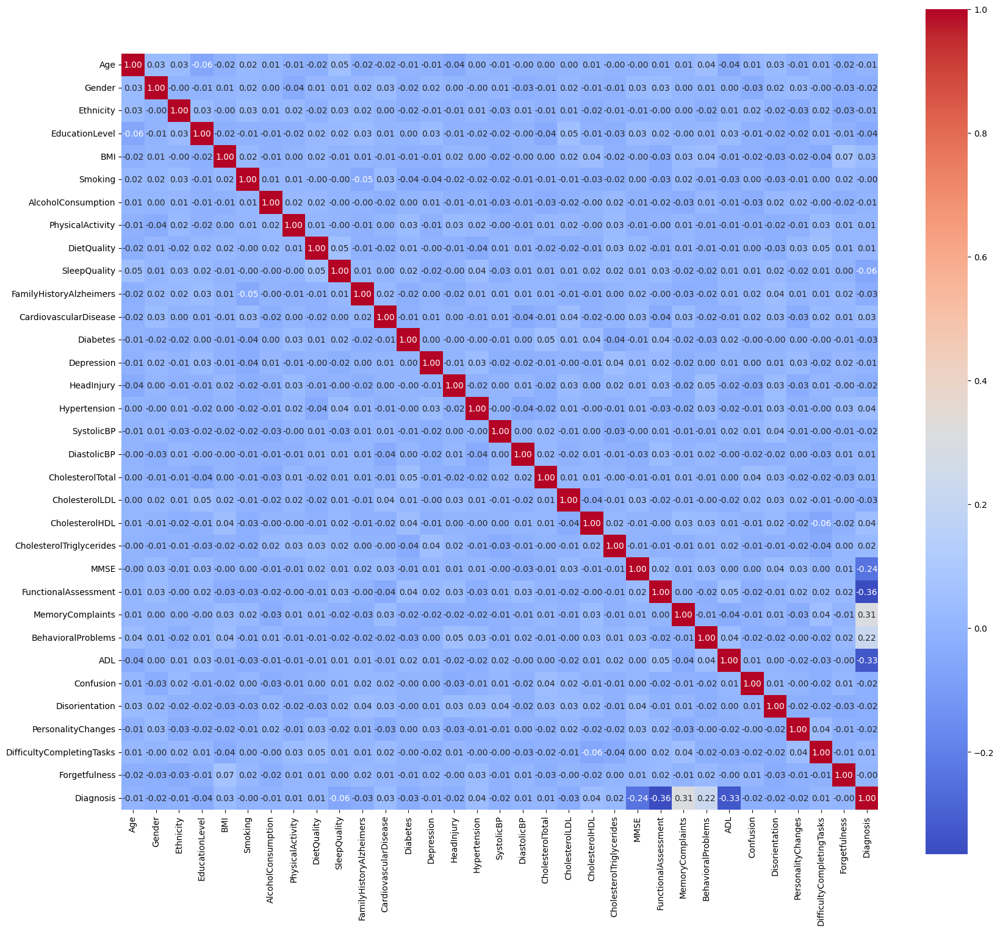

In [10]:
correlation_matrix = the_data.corr()
plt.figure(figsize = (20, 18))
sns.heatmap(correlation_matrix, annot = True, fmt=".2f", cmap="coolwarm", square = True)
#plt.title("Heatmap of Feature Correlations")
plt.show()

### Actual Study Plots

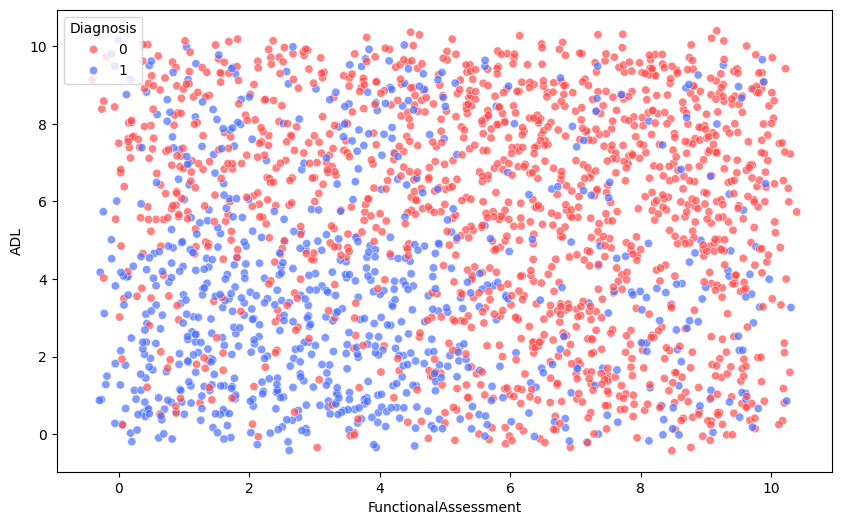

In [11]:
# First plot: FunctionalAssessment vs ADL by Diagnosis (with opacity and jitter)
plt.figure(figsize = (10, 6))

# Adding jitter by manually adding small random noise to the data
jitter_strength = 0.5
data_jittered = the_data.copy()
data_jittered['FunctionalAssessment'] += np.random.uniform(-jitter_strength, jitter_strength, len(the_data))
data_jittered['ADL'] += np.random.uniform(-jitter_strength, jitter_strength, len(the_data))

custom_palette = {0: "#FF4C4C", 1: "#4C6FFF"}  # Vivid red and blue

sns.scatterplot(data=data_jittered, x="FunctionalAssessment", y="ADL", hue="Diagnosis", palette=custom_palette, 
                edgecolor='w', marker='o', alpha=0.7)  # alpha=0.7 for opacity
#plt.title('FunctionalAssessment vs ADL by Diagnosis (with opacity and jitter)')
plt.xlabel('FunctionalAssessment')
plt.ylabel('ADL')
plt.legend(title="Diagnosis")
plt.show()

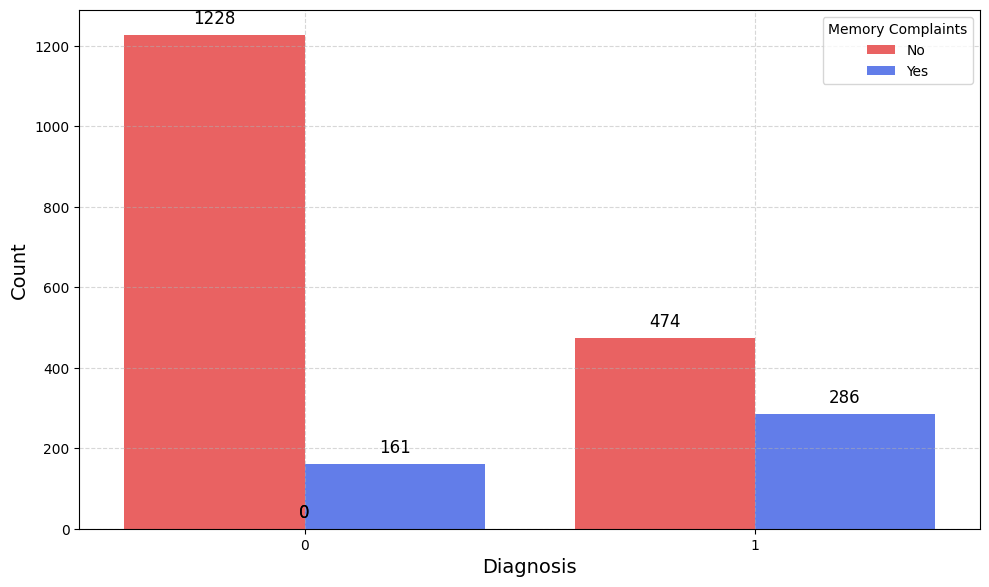

In [12]:
# Create the count plot
plt.figure(figsize=(10, 6))
custom_palette = {0: "#FF4C4C", 1: "#4C6FFF"}
ax = sns.countplot(data=the_data, x='Diagnosis', hue='MemoryComplaints', palette=custom_palette)

# Set titles and labels
#plt.title('Memory Complaints by Diagnosis', fontsize=16)
plt.xlabel('Diagnosis', fontsize=14)
plt.ylabel('Count', fontsize=14)
plt.legend(title='Memory Complaints', loc='upper right', labels=['No', 'Yes'])
plt.grid(True, linestyle='--', alpha=0.5)

# Annotate bars with actual counts
for p in ax.patches:
    count = int(p.get_height())
    ax.annotate(count, 
                (p.get_x() + p.get_width() / 2., p.get_height()), 
                ha='center', va='bottom', 
                fontsize=12, color='black', 
                xytext=(0, 5),  # 5 points vertical offset
                textcoords='offset points')

# Adjust layout and display the plot
plt.tight_layout()
plt.show()

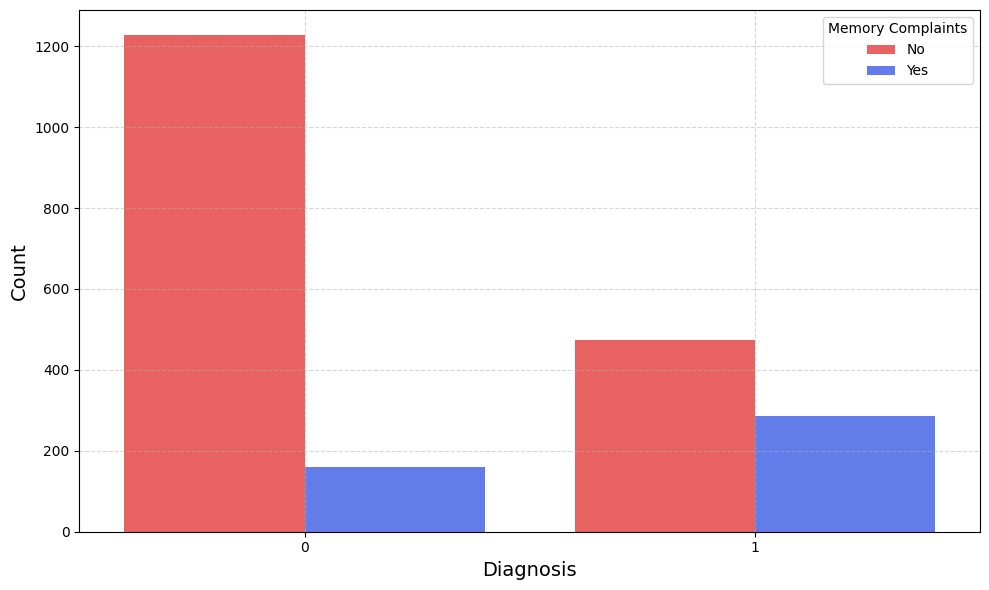

In [13]:
plt.figure(figsize=(10, 6))
custom_palette = {0: "#FF4C4C", 1: "#4C6FFF"}
sns.countplot(data=the_data, x='Diagnosis', hue='MemoryComplaints', palette=custom_palette)
#plt.title('Memory Complaints by Diagnosis', fontsize=16)
plt.xlabel('Diagnosis', fontsize=14)
plt.ylabel('Count', fontsize=14)
plt.legend(title='Memory Complaints', loc='upper right', labels=['No', 'Yes'])
plt.grid(True, linestyle='--', alpha=0.5)
plt.tight_layout()
plt.show()

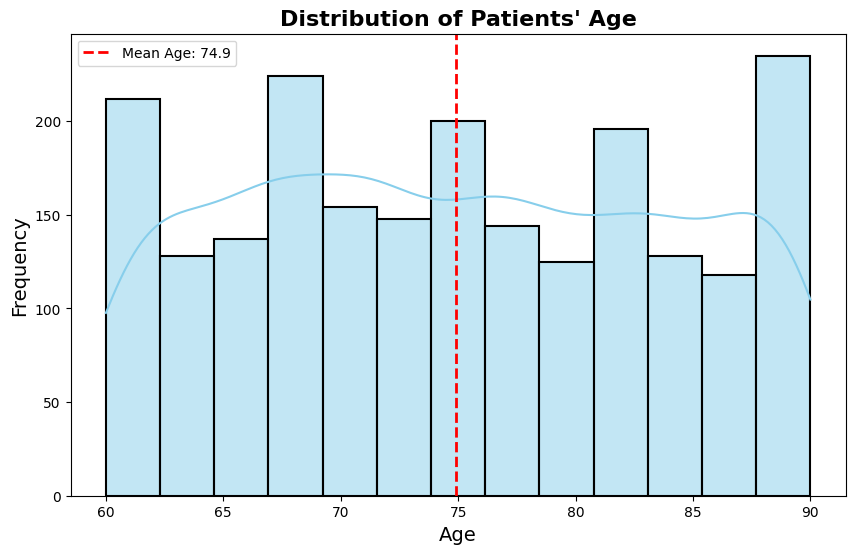

In [14]:
# Assuming 'Age' is a column in your dataset 'data'
plt.figure(figsize=(10, 6))  # Adjust the size of the figure

# Create a histogram with KDE for Age
sns.histplot(the_data['Age'], kde=True, color='skyblue', edgecolor='black', linewidth=1.5)

# Add title and labels with improved formatting
plt.title('Distribution of Patients\' Age', fontsize=16, fontweight='bold')
plt.xlabel('Age', fontsize=14)
plt.ylabel('Frequency', fontsize=14)

# Highlight the mean age with a vertical line
mean_age = the_data['Age'].mean()
plt.axvline(mean_age, color='red', linestyle='--', linewidth=2, label=f'Mean Age: {mean_age:.1f}')

# Add a legend for the mean age line
plt.legend()

# Display the plot
plt.grid(False)
plt.show()

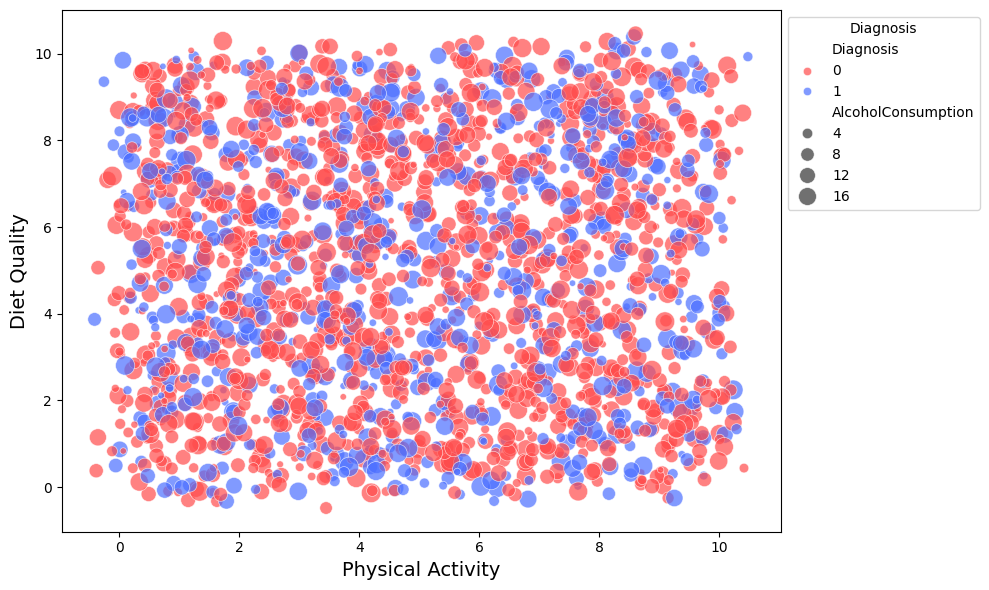

In [15]:
plt.figure(figsize=(10, 6))

# Adding jitter to avoid overplotting
jitter_strength = 0.5  # Adjust if necessary
data_jittered = the_data.copy()
data_jittered['PhysicalActivity'] += np.random.uniform(-jitter_strength, jitter_strength, len(the_data))
data_jittered['DietQuality'] += np.random.uniform(-jitter_strength, jitter_strength, len(the_data))

custom_palette = {0: "#FF4C4C", 1: "#4C6FFF"}

# Scatter plot
sns.scatterplot(data=data_jittered, x="PhysicalActivity", y="DietQuality", hue="Diagnosis", 
                size="AlcoholConsumption", palette=custom_palette, sizes=(20, 200), 
                edgecolor='w', marker='o', alpha=0.7)

#plt.title('Physical Activity vs Diet Quality vs Alcohol Consumption by Diagnosis (with opacity and jitter)', fontsize=16)
plt.xlabel('Physical Activity', fontsize=14)
plt.ylabel('Diet Quality', fontsize=14)

# Adjusting the legend position
plt.legend(title="Diagnosis", loc='upper left', bbox_to_anchor=(1, 1))
plt.tight_layout()
plt.show()

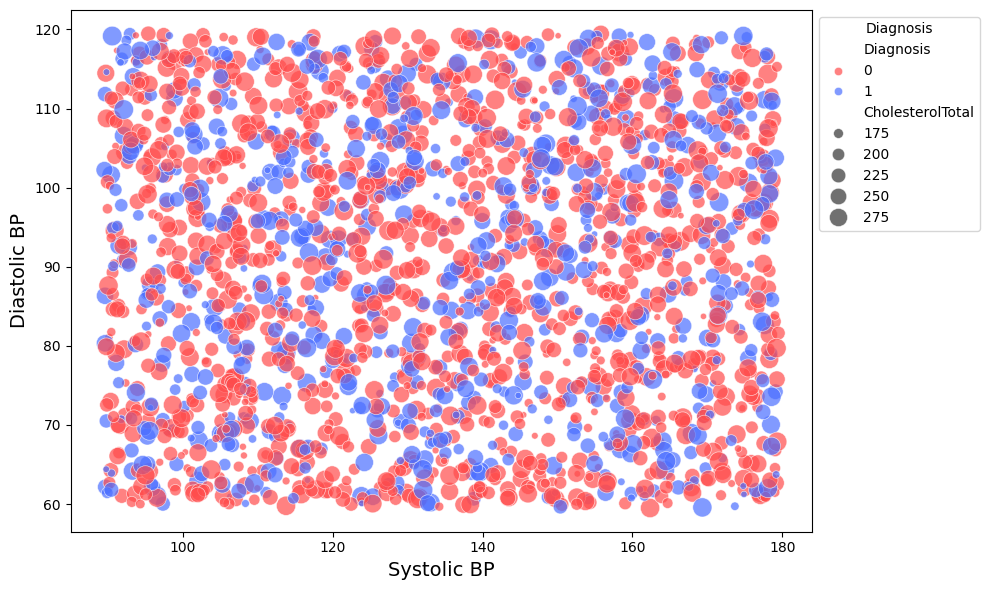

In [16]:
plt.figure(figsize=(10, 6))

# Adding jitter to avoid overplotting
jitter_strength = 0.5  # Adjust if necessary
data_jittered = the_data.copy()
data_jittered['SystolicBP'] += np.random.uniform(-jitter_strength, jitter_strength, len(the_data))
data_jittered['DiastolicBP'] += np.random.uniform(-jitter_strength, jitter_strength, len(the_data))

custom_palette = {0: "#FF4C4C", 1: "#4C6FFF"}

# Scatter plot
sns.scatterplot(data=data_jittered, x="SystolicBP", y="DiastolicBP", hue="Diagnosis", 
                size="CholesterolTotal", palette=custom_palette, sizes=(20, 200), 
                edgecolor='w', marker='o', alpha=0.7)

#plt.title('Systolic BP vs Diastolic BP vs Cholesterol Total by Diagnosis (with opacity and jitter)', fontsize=16)
plt.xlabel('Systolic BP', fontsize=14)
plt.ylabel('Diastolic BP', fontsize=14)

# Adjusting the legend position
plt.legend(title="Diagnosis", loc='upper left', bbox_to_anchor=(1, 1))
plt.tight_layout()
plt.show()

## Preprocessing

### Splitting, Balancing (SMOTE) and Standardizing the data

In [17]:
x = the_data.drop(['Diagnosis'], axis = 1)
y = the_data['Diagnosis']

x_train_almost, x_test_almost, y_train, y_test = train_test_split(x, y, test_size = 0.2, random_state = 42)

smote = SMOTE(sampling_strategy = 'minority', random_state = 42)
x_train_smote, y_train_smote = smote.fit_resample(x_train_almost, y_train)

x_train_almost = x_train_smote
y_train = y_train_smote

scaler_minmax = MinMaxScaler()
x_train = pd.DataFrame(scaler_minmax.fit_transform(x_train_almost))
x_test = pd.DataFrame(scaler_minmax.transform(x_test_almost))

## Contructing Models

### Takagi-Sugeno (Fuzzy Modeling)

In [18]:
var_names = x_train_almost.columns

x_train_array = x_train.to_numpy()

# Cluster the input-output space
cl = Clusterer(x_train = x_train_array, y_train = y_train, nr_clus = 10)
clust_centers, part_matrix, _ = cl.cluster(method = 'fcm')

# Estimate membership functions parameters
ae = AntecedentEstimator(x_train_array, part_matrix)
antecedent_params = ae.determineMF()

# Estimate consequent parameters
ce = ConsequentEstimator(x_train_array, y_train, part_matrix)
conseq_params = ce.suglms()

# Build First-Order Takagi-Sugeno model
modbuilder = SugenoFISBuilder(antecedent_params, conseq_params, var_names, save_simpful_code = False)
model_ts = modbuilder.get_model()

 * Detected 10 rules / clusters
 * Detected Sugeno model type


### One-Layer Neural Network

In [19]:
model_nn = MLPClassifier(max_iter = 2000, random_state = 42)

### Two-Layer Neural Network

In [20]:
model_nn_2l = MLPClassifier(hidden_layer_sizes = (100, 100), max_iter = 2000, random_state = 42)

### Support Vector Machines (SVMs)

In [21]:
model_svm = SVC(probability = True, random_state = 42)

### Decision Tree

In [22]:
model_dt = DecisionTreeClassifier(random_state = 42)

## Training the Models

### K-Fold Cross-Validation

In [23]:
cv = StratifiedKFold(n_splits = 5, shuffle = True, random_state = 42)

#### Takagi-Sugeno

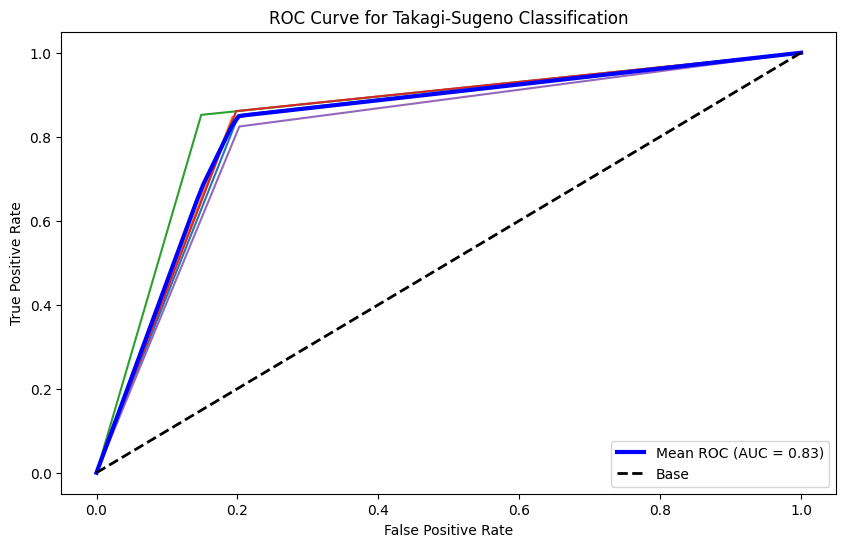

In [24]:
mean_fpr_ts = np.linspace(0, 1, 100)
mean_tpr_ts = 0

plt.figure(figsize = (10, 6))

for train, val in cv.split(x_train_almost, y_train):
    x_train_fold = pd.DataFrame(scaler_minmax.fit_transform(x_train_almost.iloc[train].values))
    x_val_fold = pd.DataFrame(scaler_minmax.transform(x_train_almost.iloc[val].values))
    y_train_fold = y_train.iloc[train].values.ravel()
    y_val_fold = y_train.iloc[val].values

    modtester = SugenoFISTester(model_ts, x_val_fold.to_numpy(), var_names)
    y_pred_probs = modtester.predict()[0]
    y_pred_probs = np.array(y_pred_probs)

    y_pred_probs = np.clip(y_pred_probs, 0, 1)
    y_pred_probs = np.column_stack((1 - y_pred_probs, y_pred_probs))
    pred_ts_fold = np.argmax(y_pred_probs, axis=1)
    
    
    fpr, tpr, _ = roc_curve(y_val_fold, pred_ts_fold)
    mean_tpr_ts += np.interp(mean_fpr_ts, fpr, tpr)

    plt.plot(fpr, tpr)

mean_tpr_ts /= cv.get_n_splits(x_train, y_train)

mean_auc_ts = auc(mean_fpr_ts, mean_tpr_ts)

plt.plot(mean_fpr_ts, mean_tpr_ts, linestyle = 'solid', color = 'b', label = f'Mean ROC (AUC = {mean_auc_ts:.2f})', linewidth = 3)
plt.plot([0, 1], [0, 1], linestyle = '--', color = 'black', label = 'Base', linewidth = 2)
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title('ROC Curve for Takagi-Sugeno Classification')
plt.legend(loc = 'lower right')
plt.show()

#### One-Layer Neural Network

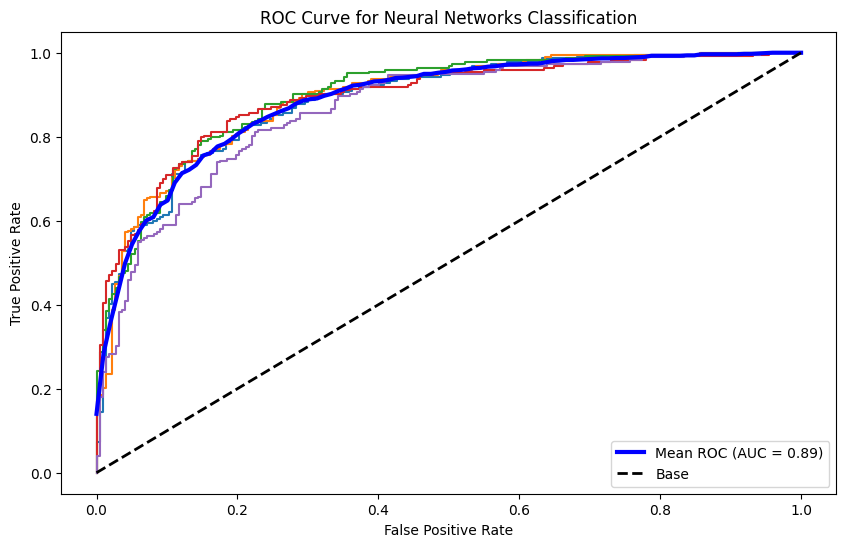

In [25]:
mean_fpr_nn = np.linspace(0, 1, 100)
mean_tpr_nn = 0

plt.figure(figsize = (10, 6))

for train, val in cv.split(x_train_almost, y_train):
    x_train_fold = pd.DataFrame(scaler_minmax.fit_transform(x_train_almost.iloc[train].values))
    x_val_fold = pd.DataFrame(scaler_minmax.transform(x_train_almost.iloc[val].values))
    y_train_fold = y_train.iloc[train].values.ravel()
    y_val_fold = y_train.iloc[val].values

    model_nn.fit(x_train_fold, y_train_fold)
    pred_nn_fold = model_nn.predict_proba(x_val_fold)[:, 1]
    fpr, tpr, _ = roc_curve(y_val_fold, pred_nn_fold)
    mean_tpr_nn += np.interp(mean_fpr_nn, fpr, tpr)

    plt.plot(fpr, tpr)

mean_tpr_nn /= cv.get_n_splits(x_train, y_train)

mean_auc_nn = auc(mean_fpr_nn, mean_tpr_nn)

plt.plot(mean_fpr_nn, mean_tpr_nn, linestyle = 'solid', color = 'b', label = f'Mean ROC (AUC = {mean_auc_nn:.2f})', linewidth = 3)
plt.plot([0, 1], [0, 1], linestyle = '--', color = 'black', label = 'Base', linewidth = 2)
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title('ROC Curve for Neural Networks Classification')
plt.legend(loc = 'lower right')
plt.show()

#### Two-Layer Neural Network

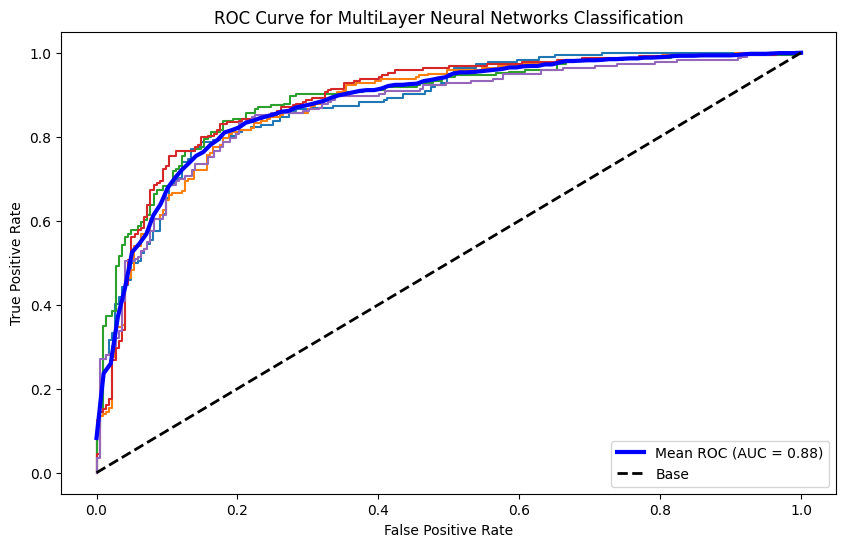

In [26]:
mean_fpr_nn_2l = np.linspace(0, 1, 100)
mean_tpr_nn_2l = 0

plt.figure(figsize = (10, 6))

for train, val in cv.split(x_train_almost, y_train):
    x_train_fold = pd.DataFrame(scaler_minmax.fit_transform(x_train_almost.iloc[train].values))
    x_val_fold = pd.DataFrame(scaler_minmax.transform(x_train_almost.iloc[val].values))
    y_train_fold = y_train.iloc[train].values.ravel()
    y_val_fold = y_train.iloc[val].values

    model_nn_2l.fit(x_train_fold, y_train_fold)
    pred_nn_2l_fold = model_nn_2l.predict_proba(x_val_fold)[:, 1]
    fpr, tpr, _ = roc_curve(y_val_fold, pred_nn_2l_fold)
    mean_tpr_nn_2l += np.interp(mean_fpr_nn_2l, fpr, tpr)

    plt.plot(fpr, tpr)

mean_tpr_nn_2l /= cv.get_n_splits(x_train, y_train)

mean_auc_nn_2l = auc(mean_fpr_nn_2l, mean_tpr_nn_2l)

plt.plot(mean_fpr_nn_2l, mean_tpr_nn_2l, linestyle = 'solid', color = 'b', label = f'Mean ROC (AUC = {mean_auc_nn_2l:.2f})', linewidth = 3)
plt.plot([0, 1], [0, 1], linestyle = '--', color = 'black', label = 'Base', linewidth = 2)
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title('ROC Curve for MultiLayer Neural Networks Classification')
plt.legend(loc = 'lower right')
plt.show()

#### Support Vector Machines (SVMs)

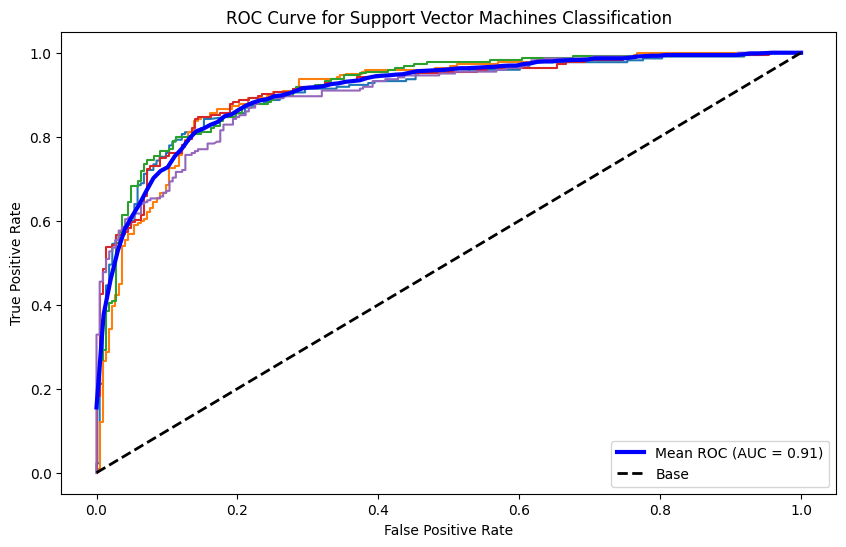

In [27]:
mean_fpr_svm = np.linspace(0, 1, 100)
mean_tpr_svm = 0

plt.figure(figsize = (10, 6))

for train, val in cv.split(x_train_almost, y_train):
    x_train_fold = pd.DataFrame(scaler_minmax.fit_transform(x_train_almost.iloc[train].values))
    x_val_fold = pd.DataFrame(scaler_minmax.transform(x_train_almost.iloc[val].values))
    y_train_fold = y_train.iloc[train].values.ravel()
    y_val_fold = y_train.iloc[val].values

    model_svm.fit(x_train_fold, y_train_fold)
    pred_nn_svm_fold = model_svm.predict_proba(x_val_fold)[:, 1]
    fpr, tpr, _ = roc_curve(y_val_fold, pred_nn_svm_fold)
    mean_tpr_svm += np.interp(mean_fpr_svm, fpr, tpr)

    plt.plot(fpr, tpr)

mean_tpr_svm /= cv.get_n_splits(x_train, y_train)

mean_auc_svm = auc(mean_fpr_svm, mean_tpr_svm)

plt.plot(mean_fpr_svm, mean_tpr_svm, linestyle = 'solid', color = 'b', label = f'Mean ROC (AUC = {mean_auc_svm:.2f})', linewidth = 3)
plt.plot([0, 1], [0, 1], linestyle = '--', color = 'black', label = 'Base', linewidth = 2)
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title('ROC Curve for Support Vector Machines Classification')
plt.legend(loc = 'lower right')
plt.show()

#### Decision Tree

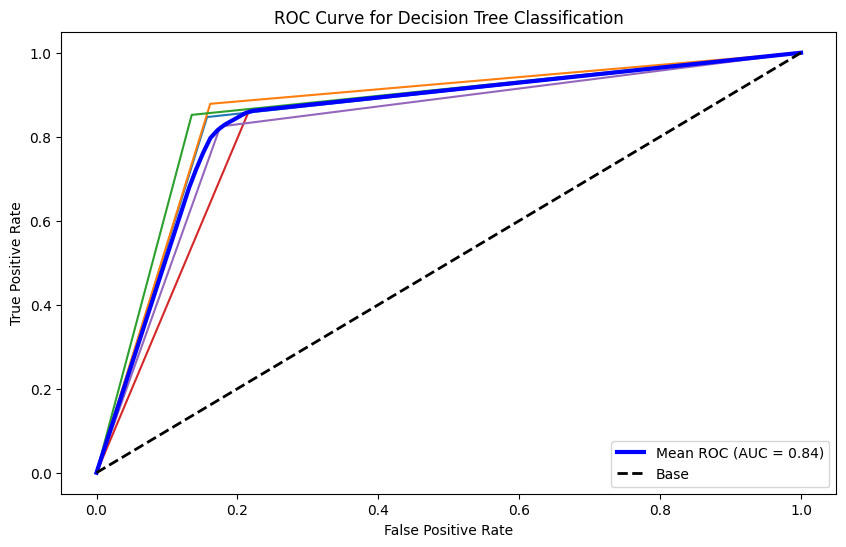

In [28]:
mean_fpr_dt = np.linspace(0, 1, 100)
mean_tpr_dt = 0

plt.figure(figsize = (10, 6))

for train, val in cv.split(x_train_almost, y_train):
    x_train_fold = pd.DataFrame(scaler_minmax.fit_transform(x_train_almost.iloc[train].values))
    x_val_fold = pd.DataFrame(scaler_minmax.transform(x_train_almost.iloc[val].values))
    y_train_fold = y_train.iloc[train].values.ravel()
    y_val_fold = y_train.iloc[val].values

    model_dt.fit(x_train_fold, y_train_fold)
    pred_dt_fold = model_dt.predict_proba(x_val_fold)[:, 1]
    fpr, tpr, _ = roc_curve(y_val_fold, pred_dt_fold)
    mean_tpr_dt += np.interp(mean_fpr_dt, fpr, tpr)

    plt.plot(fpr, tpr)

mean_tpr_dt /= cv.get_n_splits(x_train, y_train)

mean_auc_dt = auc(mean_fpr_dt, mean_tpr_dt)

plt.plot(mean_fpr_dt, mean_tpr_dt, linestyle = 'solid', color = 'b', label = f'Mean ROC (AUC = {mean_auc_dt:.2f})', linewidth = 3)
plt.plot([0, 1], [0, 1], linestyle = '--', color = 'black', label = 'Base', linewidth = 2)
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title('ROC Curve for Decision Tree Classification')
plt.legend(loc = 'lower right')
plt.show()

### Hyperparameter Tuning

#### Takagi-Sugeno -> Manual Hyperparameter Tuning with PyFume

In [29]:
# Define parameters for tuning

# Cluestering Parameters
clustering_params = {
    'nr_clus': [5, 10, 15, 20],
    'distance_metric': ['euclidean', 'manhattan'],
    'max_iterations_clustering': [100, 200, 300]
}

# Membership Function Parameters
membership_params = {'membership_function': ['gauss', 'gauss2']}

# Sugeno LMS Parameters
suglms_params = {'global_fit': [False, True]}

# Generate all combinations of hyperparameters
param_grid = {**clustering_params, **suglms_params, **membership_params}
param_combination = list(itertools.product(*param_grid.values()))

# Initialize best of each tracker
best_model = None
best_score = 0
best_params = {}

# Iterate over every combination
for params in param_combination:
    # Create a dictionary of current parameters
    current_params = dict(zip(param_grid.keys(), params))

    # Cluster the input_outup space
    cl = Clusterer(x_train = x_train_array, y_train = y_train, 
                   nr_clus = int(current_params['nr_clus']),
    )
    
    clust_centers, part_matrix, _ = cl.cluster(
        method = 'fcm',
        max_iterations = int(current_params['max_iterations_clustering']),
        distance_metric = current_params['distance_metric']
    )

    # Estimate membership functions parameter
    ae = AntecedentEstimator(x_train_array, part_matrix)
    antecedent_params = ae.determineMF(mf_shape = current_params['membership_function'])

    # Estimate consequent parameters
    ce = ConsequentEstimator(x_train_array, y_train, part_matrix)
    conseq_params = ce.suglms(global_fit = current_params['global_fit'])

    # Build First-Order Takagi-Sugeno model
    modbuilder = SugenoFISBuilder(antecedent_params, conseq_params, var_names, save_simpful_code = False)
    model_ts = modbuilder.get_model()

    # Test the model
    modtester = SugenoFISTester(model_ts, x_train_array, var_names)
    y_pred_probs = modtester.predict()[0]
    y_pred_probs = np.array(y_pred_probs)

    # Prepare the predictions
    y_pred_probs = np.clip(y_pred_probs, 0, 1)
    y_pred_probs = np.column_stack((1 - y_pred_probs, y_pred_probs))
    pred_ts_fold = np.argmax(y_pred_probs, axis=1)

    # Calculate the recall score
    score = roc_auc_score(y_train, pred_ts_fold)

    # Check if it is the best score
    if score > best_score:
        best_score = score
        best_model = model_ts
        best_params = current_params

print('Best Hyperparameters: ', best_params)
print(f'Best AUC Score: {best_score:.4f}')

 * Detected 5 rules / clusters
 * Detected Sugeno model type
 * Detected 5 rules / clusters
 * Detected Sugeno model type
 * Detected 5 rules / clusters
 * Detected Sugeno model type
 * Detected 5 rules / clusters
 * Detected Sugeno model type
 * Detected 5 rules / clusters
 * Detected Sugeno model type
 * Detected 5 rules / clusters
 * Detected Sugeno model type
 * Detected 5 rules / clusters
 * Detected Sugeno model type
 * Detected 5 rules / clusters
 * Detected Sugeno model type
 * Detected 5 rules / clusters
 * Detected Sugeno model type
 * Detected 5 rules / clusters
 * Detected Sugeno model type
 * Detected 5 rules / clusters
 * Detected Sugeno model type
 * Detected 5 rules / clusters
 * Detected Sugeno model type
 * Detected 5 rules / clusters
 * Detected Sugeno model type
 * Detected 5 rules / clusters
 * Detected Sugeno model type
 * Detected 5 rules / clusters
 * Detected Sugeno model type
 * Detected 5 rules / clusters
 * Detected Sugeno model type
 * Detected 5 rules / cl

#### Grid Search

##### One-Layer Neural Network

In [30]:
grid_parameters_nn = {
    'learning_rate_init': [0.001, 0.01, 0.1],
    'activation': ['relu', 'logistic', 'tanh'],
    'hidden_layer_sizes': [(50,), (100,), (150,)]
}

grid_search_nn = GridSearchCV(model_nn, grid_parameters_nn, cv = 5, scoring = 'roc_auc', n_jobs = -1)

grid_search_nn.fit(x_train, y_train.values.ravel())

best_params_nn = grid_search_nn.best_params_
best_auc_nn = grid_search_nn.best_score_

print('Best Hyperparameters:', best_params_nn)
print(f'Best AUC Score: {best_auc_nn:.4f}')

Best Hyperparameters: {'activation': 'tanh', 'hidden_layer_sizes': (50,), 'learning_rate_init': 0.001}
Best AUC Score: 0.8943


##### Two-Layer Neural Network

In [31]:
grid_parameters_nn_2l = {
    'learning_rate_init': [0.001, 0.01, 0.1],
    'activation': ['relu', 'logistic', 'tanh'],
    'hidden_layer_sizes': [(50, 50), (100, 100), (50, 100), (100, 50)]
}

grid_search_nn_2l = GridSearchCV(model_nn_2l, grid_parameters_nn_2l, cv = 5, scoring = 'roc_auc', n_jobs = -1)

grid_search_nn_2l.fit(x_train, y_train.values.ravel())

best_params_nn_2l = grid_search_nn_2l.best_params_
best_auc_nn_2l = grid_search_nn_2l.best_score_

print('Best Hyperparameters:', best_params_nn_2l)
print(f'Best AUC Score: {best_auc_nn_2l:.4f}')

Best Hyperparameters: {'activation': 'tanh', 'hidden_layer_sizes': (100, 100), 'learning_rate_init': 0.001}
Best AUC Score: 0.9130


##### Support Vector Machines (SVMs)

In [32]:
grid_parameters_svm = {
    'C' : [0.1, 1, 10, 100],
    'kernel': ['linear', 'poly', 'rbf']
}

grid_search_svm = GridSearchCV(model_svm, grid_parameters_svm, cv = 5, scoring = 'roc_auc', n_jobs = -1)

grid_search_svm.fit(x_train, y_train.values.ravel())

best_params_svm = grid_search_svm.best_params_
best_auc_svm = grid_search_svm.best_score_

print('Best Hyperparameters:', best_params_svm)
print(f'Best AUC Score: {best_auc_svm:.4f}')

Best Hyperparameters: {'C': 10, 'kernel': 'rbf'}
Best AUC Score: 0.9039


##### Decision Tree

In [33]:
grid_parameters_dt = {
    'max_depth': [None, 10, 20, 30, 40, 50],
    'min_samples_split': [0.1, 0.2, 2, 5, 10, 15, 20]
}

grid_search_dt = GridSearchCV(model_dt, grid_parameters_dt, cv = 5, scoring = 'roc_auc', n_jobs = -1)

grid_search_dt.fit(x_train, y_train.values.ravel())

best_params_dt = grid_search_dt.best_params_
best_auc_dt = grid_search_dt.best_score_

print('Best Hyperparameters:', best_params_dt)
print(f'Best AUC Score: {best_auc_dt:.4f}')

Best Hyperparameters: {'max_depth': None, 'min_samples_split': 0.1}
Best AUC Score: 0.9008


### Feature Selection

#### Takagi-Sugeno

In [34]:
# Setting optimized parameters to make the selection faster
selector = FeatureSelector(
    dataX = x_train_array,
    dataY = y_train.to_numpy(),
    nr_clus = 5,
    variable_names=var_names
)

# Reduce max_iter for faster convergence, and set a narrow cluster range
selected_features, selected_feature_names, optimal_number_clusters = selector.fst_pso_feature_selection(
    max_iter = 50,       # Reduces iterations from the default to speed up
    min_clusters = 3,    # Limits the cluster range to a narrower band
    max_clusters = 7,
    performance_metric = 'auc_score'  # Maintain MAE for consistency, optional change to 'MSE' or another metric if relevant
)

# Use selected features for the model training
x_train_selected = x_train.iloc[:, selected_features]

Fuzzy Self-Tuning PSO - v1.8.1
 * Discrete case detected, with the following choices: [[True, False], [True, False], [True, False], [True, False], [True, False], [True, False], [True, False], [True, False], [True, False], [True, False], [True, False], [True, False], [True, False], [True, False], [True, False], [True, False], [True, False], [True, False], [True, False], [True, False], [True, False], [True, False], [True, False], [True, False], [True, False], [True, False], [True, False], [True, False], [True, False], [True, False], [True, False], [True, False]]
 * Max distance: 8.000000
 * FST-PSO converted the 32D discrete problem to a 64D real valued probabilistic problem.
 * Search space boundaries automatically set to: [[0, 1], [0, 1], [0, 1], [0, 1], [0, 1], [0, 1], [0, 1], [0, 1], [0, 1], [0, 1], [0, 1], [0, 1], [0, 1], [0, 1], [0, 1], [0, 1], [0, 1], [0, 1], [0, 1], [0, 1], [0, 1], [0, 1], [0, 1], [0, 1], [0, 1], [0, 1], [0, 1], [0, 1], [0, 1], [0, 1], [0, 1], [0, 1], [0, 1], [0,

In [35]:
x_train_selected_array = x_train_selected.to_numpy()

# Cluster the input-output space
cl = Clusterer(x_train = x_train_selected_array, y_train = y_train, nr_clus = 5)
clust_centers, part_matrix, _ = cl.cluster(method = 'fcm', distance_metrics = 'euclidean', max_iterations = 100)

# Estimate membership functions parameters
ae = AntecedentEstimator(x_train_selected_array, part_matrix)
antecedent_params = ae.determineMF(mf_shape = 'gauss')

# Estimate consequent parameters
ce = ConsequentEstimator(x_train_selected_array, y_train, part_matrix)
conseq_params = ce.suglms(global_fit = False)

# Build First-Order Takagi-Sugeno model
modbuilder = SugenoFISBuilder(antecedent_params, conseq_params, selected_feature_names, save_simpful_code = False)
best_model_ts = modbuilder.get_model()

 * Detected 5 rules / clusters
 * Detected Sugeno model type


#### One-Layer Neural Network

In [36]:
best_model_nn = MLPClassifier(learning_rate_init = 0.001,activation = 'tanh', hidden_layer_sizes = (50,), max_iter = 2000, random_state = 42)
cv = StratifiedKFold(n_splits = 5, shuffle = True, random_state = 42)

features = list(x_train_almost.columns)
best_features_nn = []
selected_features_nn = []
best_auc_nn = -1
print('it works to change before runing')

while features:
    current_auc_scores_nn = []

    for feature in features:
        current_features = best_features_nn + [feature]

        if feature in best_features_nn:
            continue

        auc_scores_nn = []

        for train_idx, val_idx in cv.split(x_train_almost[current_features], y_train):
            x_train_fold = pd.DataFrame(scaler_minmax.fit_transform(x_train_almost[current_features].iloc[train_idx]))
            x_val_fold = pd.DataFrame(scaler_minmax.transform(x_train_almost[current_features].iloc[val_idx]))
            y_train_fold = y_train.iloc[train_idx].values.ravel()
            y_val_fold = y_train.iloc[val_idx].values.ravel() 

            model_subset = MLPClassifier(learning_rate_init = 0.001, activation = 'tanh', hidden_layer_sizes = (50,), max_iter = 2000, random_state = 42)
            model_subset.fit(x_train_fold, y_train_fold)

            y_pred = model_subset.predict(x_val_fold)
            auc_nn = roc_auc_score(y_val_fold, y_pred)
            auc_scores_nn.append(auc_nn)

        mean_auc = np.mean(auc_scores_nn)
        current_auc_scores_nn.append(mean_auc)

    best_index = np.argmax(current_auc_scores_nn)
    best_feature = features[best_index]
    best_feature_auc = current_auc_scores_nn[best_index]
    selected_features_nn.append(best_feature)
    features.remove(best_feature)

    print(f'Selected Features: {selected_features_nn}')
    print(f'Mean Recall Score: {best_feature_auc:.4f}')

    if best_feature_auc > best_auc_nn:
        best_auc_nn = best_feature_auc
        best_features_nn.append(best_feature)
        
        print(f'---> Best Features so far: {best_features_nn}')

final_x_train_nn = pd.DataFrame(scaler_minmax.fit_transform(x_train_almost[best_features_nn]))
best_model_nn.fit(final_x_train_nn, y_train.values.ravel())

print('-----------------')
print(f'Best Features: {best_features_nn}')
print(f'Final Mean AUC: {best_auc_nn:.4f}')

it works to change before runing
Selected Features: ['FunctionalAssessment']
Mean Recall Score: 0.7172
---> Best Features so far: ['FunctionalAssessment']
Selected Features: ['FunctionalAssessment', 'ADL']
Mean Recall Score: 0.7307
---> Best Features so far: ['FunctionalAssessment', 'ADL']
Selected Features: ['FunctionalAssessment', 'ADL', 'MemoryComplaints']
Mean Recall Score: 0.7702
---> Best Features so far: ['FunctionalAssessment', 'ADL', 'MemoryComplaints']
Selected Features: ['FunctionalAssessment', 'ADL', 'MemoryComplaints', 'MMSE']
Mean Recall Score: 0.7927
---> Best Features so far: ['FunctionalAssessment', 'ADL', 'MemoryComplaints', 'MMSE']
Selected Features: ['FunctionalAssessment', 'ADL', 'MemoryComplaints', 'MMSE', 'BehavioralProblems']
Mean Recall Score: 0.7950
---> Best Features so far: ['FunctionalAssessment', 'ADL', 'MemoryComplaints', 'MMSE', 'BehavioralProblems']
Selected Features: ['FunctionalAssessment', 'ADL', 'MemoryComplaints', 'MMSE', 'BehavioralProblems', 'Sys

#### Two-Layer Neural Network

In [37]:
best_model_nn_2l = MLPClassifier(learning_rate_init = 0.001, activation = 'tanh', hidden_layer_sizes = (100, 100), max_iter = 2000, random_state = 42)
cv = StratifiedKFold(n_splits = 5, shuffle = True, random_state = 42)

features = list(x_train_almost.columns)
best_features_nn_2l = []
selected_features_nn_2l = []
best_auc_nn_2l = -1

while features:
    current_auc_scores_nn_2l = []

    for feature in features:
        current_features = best_features_nn_2l + [feature]

        if feature in best_features_nn_2l:
            continue

        auc_scores_nn_2l = []

        for train_idx, val_idx in cv.split(x_train_almost[current_features], y_train):
            x_train_fold = pd.DataFrame(scaler_minmax.fit_transform(x_train_almost[current_features].iloc[train_idx]))
            x_val_fold = pd.DataFrame(scaler_minmax.transform(x_train_almost[current_features].iloc[val_idx]))
            y_train_fold = y_train.iloc[train_idx].values.ravel()
            y_val_fold = y_train.iloc[val_idx].values.ravel() 

            model_subset = MLPClassifier(learning_rate_init = 0.001, activation = 'tanh', hidden_layer_sizes = (100, 100), max_iter = 2000, random_state = 42)
            model_subset.fit(x_train_fold, y_train_fold)

            y_pred = model_subset.predict(x_val_fold)
            auc_nn_2l = roc_auc_score(y_val_fold, y_pred)
            auc_scores_nn_2l.append(auc_nn_2l)

        mean_auc = np.mean(auc_scores_nn_2l)
        current_auc_scores_nn_2l.append(mean_auc)

    best_index = np.argmax(current_auc_scores_nn_2l)
    best_feature = features[best_index]
    best_feature_auc = current_auc_scores_nn_2l[best_index]
    selected_features_nn_2l.append(best_feature)
    features.remove(best_feature)

    print(f'Selected Features: {selected_features_nn_2l}')
    print(f'Mean AUC Score: {best_feature_auc:.4f}')

    if best_feature_auc > best_auc_nn_2l:
        best_auc_nn_2l = best_feature_auc
        best_features_nn_2l.append(best_feature)
        
        print(f'---> Best Features so far: {best_features_nn_2l}')

final_x_train_nn_2l = pd.DataFrame(scaler_minmax.fit_transform(x_train_almost[best_features_nn_2l]))
best_model_nn_2l.fit(final_x_train_nn_2l, y_train.values.ravel())

print('-----------------')
print(f'Best Features: {best_features_nn_2l}')
print(f'Final Mean AUC: {best_auc_nn_2l:.4f}')

Selected Features: ['FunctionalAssessment']
Mean AUC Score: 0.7163
---> Best Features so far: ['FunctionalAssessment']
Selected Features: ['FunctionalAssessment', 'MMSE']
Mean AUC Score: 0.7491
---> Best Features so far: ['FunctionalAssessment', 'MMSE']
Selected Features: ['FunctionalAssessment', 'MMSE', 'MemoryComplaints']
Mean AUC Score: 0.7945
---> Best Features so far: ['FunctionalAssessment', 'MMSE', 'MemoryComplaints']
Selected Features: ['FunctionalAssessment', 'MMSE', 'MemoryComplaints', 'ADL']
Mean AUC Score: 0.7932
Selected Features: ['FunctionalAssessment', 'MMSE', 'MemoryComplaints', 'ADL', 'HeadInjury']
Mean AUC Score: 0.7572
Selected Features: ['FunctionalAssessment', 'MMSE', 'MemoryComplaints', 'ADL', 'HeadInjury', 'BehavioralProblems']
Mean AUC Score: 0.7559
Selected Features: ['FunctionalAssessment', 'MMSE', 'MemoryComplaints', 'ADL', 'HeadInjury', 'BehavioralProblems', 'DifficultyCompletingTasks']
Mean AUC Score: 0.7405
Selected Features: ['FunctionalAssessment', 'MMS

#### Support Vector Machines (SVMs)

In [38]:
best_model_svm = SVC(C = 10, kernel = 'rbf', probability = True, random_state = 42)
cv = StratifiedKFold(n_splits = 5, shuffle = True, random_state = 42)

features = list(x_train_almost.columns)
best_features_svm = []
selected_features_svm = []
best_auc_svm = -1

while features:
    current_auc_scores_svm = []

    for feature in features:
        current_features = best_features_svm + [feature]

        if feature in best_features_svm:
            continue

        auc_scores_svm = []

        for train_idx, val_idx in cv.split(x_train_almost[current_features], y_train):
            x_train_fold = pd.DataFrame(scaler_minmax.fit_transform(x_train_almost[current_features].iloc[train_idx]))
            x_val_fold = pd.DataFrame(scaler_minmax.transform(x_train_almost[current_features].iloc[val_idx]))
            y_train_fold = y_train.iloc[train_idx].values.ravel()
            y_val_fold = y_train.iloc[val_idx].values.ravel() 

            model_subset = SVC(C = 10, kernel = 'rbf', probability = True, random_state = 42)
            model_subset.fit(x_train_fold, y_train_fold)

            y_pred = model_subset.predict(x_val_fold)
            auc_svm = roc_auc_score(y_val_fold, y_pred)
            auc_scores_svm.append(auc_svm)

        mean_recall = np.mean(auc_scores_svm)
        current_auc_scores_svm.append(mean_auc)

    best_index = np.argmax(current_auc_scores_svm)
    best_feature = features[best_index]
    best_feature_auc = current_auc_scores_svm[best_index]
    selected_features_svm.append(best_feature)
    features.remove(best_feature)

    print(f'Selected Features: {selected_features_svm}')
    print(f'Mean AUC Score: {best_feature_auc:.4f}')

    if best_feature_auc > best_auc_svm:
        best_auc_svm = best_feature_auc
        best_features_svm.append(best_feature)
        
        print(f'---> Best Features so far: {best_features_svm}')

final_x_train_svm = pd.DataFrame(scaler_minmax.fit_transform(x_train_almost[best_features_svm]))
best_model_svm.fit(final_x_train_svm, y_train.values.ravel())

print('-----------------')
print(f'Best Features: {best_features_svm}')
print(f'Final Mean AUC: {best_auc_svm:.4f}')

Selected Features: ['Age']
Mean AUC Score: 0.7203
---> Best Features so far: ['Age']
Selected Features: ['Age', 'Gender']
Mean AUC Score: 0.7203
Selected Features: ['Age', 'Gender', 'Ethnicity']
Mean AUC Score: 0.7203
Selected Features: ['Age', 'Gender', 'Ethnicity', 'EducationLevel']
Mean AUC Score: 0.7203
Selected Features: ['Age', 'Gender', 'Ethnicity', 'EducationLevel', 'BMI']
Mean AUC Score: 0.7203
Selected Features: ['Age', 'Gender', 'Ethnicity', 'EducationLevel', 'BMI', 'Smoking']
Mean AUC Score: 0.7203
Selected Features: ['Age', 'Gender', 'Ethnicity', 'EducationLevel', 'BMI', 'Smoking', 'AlcoholConsumption']
Mean AUC Score: 0.7203
Selected Features: ['Age', 'Gender', 'Ethnicity', 'EducationLevel', 'BMI', 'Smoking', 'AlcoholConsumption', 'PhysicalActivity']
Mean AUC Score: 0.7203
Selected Features: ['Age', 'Gender', 'Ethnicity', 'EducationLevel', 'BMI', 'Smoking', 'AlcoholConsumption', 'PhysicalActivity', 'DietQuality']
Mean AUC Score: 0.7203
Selected Features: ['Age', 'Gender',

#### Decision Tree

In [39]:
best_model_dt = DecisionTreeClassifier(max_depth = None, min_samples_split = 0.1, random_state = 42)
cv = StratifiedKFold(n_splits = 5, shuffle = True, random_state = 42)

features = list(x_train_almost.columns)
best_features_dt = []
selected_features_dt = []
best_auc_dt = -1

while features:
    current_auc_scores_dt = []

    for feature in features:
        current_features = best_features_dt + [feature]

        if feature in best_features_dt:
            continue

        auc_scores_dt = []

        for train_idx, val_idx in cv.split(x_train_almost[current_features], y_train):
            x_train_fold = pd.DataFrame(scaler_minmax.fit_transform(x_train_almost[current_features].iloc[train_idx]))
            x_val_fold = pd.DataFrame(scaler_minmax.transform(x_train_almost[current_features].iloc[val_idx]))
            y_train_fold = y_train.iloc[train_idx].values.ravel()
            y_val_fold = y_train.iloc[val_idx].values.ravel() 

            model_subset = DecisionTreeClassifier(max_depth = None, min_samples_split = 0.1, random_state = 42)
            model_subset.fit(x_train_fold, y_train_fold)

            y_pred = model_subset.predict(x_val_fold)
            auc_dt = roc_auc_score(y_val_fold, y_pred)
            auc_scores_dt.append(auc_dt)

        mean_auc = np.mean(auc_scores_dt)
        current_auc_scores_dt.append(mean_auc)

    best_index = np.argmax(current_auc_scores_dt)
    best_feature = features[best_index]
    best_feature_auc = current_auc_scores_dt[best_index]
    selected_features_dt.append(best_feature)
    features.remove(best_feature)

    print(f'Selected Features: {selected_features_dt}')
    print(f'Mean AUC Score: {best_feature_auc:.4f}')

    if best_feature_auc > best_auc_dt:
        best_auc_dt = best_feature_auc
        best_features_dt.append(best_feature)
        
        print(f'---> Best Features so far: {best_features_dt}')

final_x_train_dt = pd.DataFrame(scaler_minmax.fit_transform(x_train_almost[best_features_dt]))
best_model_dt.fit(final_x_train_dt, y_train.values.ravel())

print('-----------------')
print(f'Best Features: {best_features_dt}')
print(f'Final Mean AUC: {best_auc_dt:.4f}')

Selected Features: ['FunctionalAssessment']
Mean AUC Score: 0.6983
---> Best Features so far: ['FunctionalAssessment']
Selected Features: ['FunctionalAssessment', 'MMSE']
Mean AUC Score: 0.7779
---> Best Features so far: ['FunctionalAssessment', 'MMSE']
Selected Features: ['FunctionalAssessment', 'MMSE', 'Forgetfulness']
Mean AUC Score: 0.7797
---> Best Features so far: ['FunctionalAssessment', 'MMSE', 'Forgetfulness']
Selected Features: ['FunctionalAssessment', 'MMSE', 'Forgetfulness', 'BehavioralProblems']
Mean AUC Score: 0.7824
---> Best Features so far: ['FunctionalAssessment', 'MMSE', 'Forgetfulness', 'BehavioralProblems']
Selected Features: ['FunctionalAssessment', 'MMSE', 'Forgetfulness', 'BehavioralProblems', 'ADL']
Mean AUC Score: 0.8134
---> Best Features so far: ['FunctionalAssessment', 'MMSE', 'Forgetfulness', 'BehavioralProblems', 'ADL']
Selected Features: ['FunctionalAssessment', 'MMSE', 'Forgetfulness', 'BehavioralProblems', 'ADL', 'MemoryComplaints']
Mean AUC Score: 0.8

### Final Training

In [40]:
# One-Layer Neural Networks Classification
best_model_nn.fit(x_train, y_train.values.ravel())

# Two-Layers Neural Networks Classification
best_model_nn_2l.fit(x_train, y_train.values.ravel())

# Support Vector Machines (SVM) Classification
best_model_svm.fit(x_train, y_train.values.ravel())

# Random Forest Classification
best_model_dt.fit(x_train, y_train.values.ravel())

DecisionTreeClassifier(min_samples_split=0.1, random_state=42)

## Test and Compare

### Test

In [41]:
#Takagi-Sugeno Classification
modtester = SugenoFISTester(best_model_ts, x_test.to_numpy(), var_names)
y_pred_probs = modtester.predict()[0]
y_pred_probs = np.clip(y_pred_probs, 0, 1)
y_pred_probs = np.column_stack((1 - y_pred_probs, y_pred_probs))
y_pred_ts = np.argmax(y_pred_probs,axis=1)

# One-Layer Neural Networks Classification
y_pred_nn = best_model_nn.predict(x_test)

# Two_Layers Neural Networks Classification
y_pred_nn_2l = best_model_nn_2l.predict(x_test)

# Support Vector Machines (SVM) Classification
y_pred_svm = best_model_svm.predict(x_test)

# Random Forest Classification
y_pred_dt = best_model_dt.predict(x_test)

### Performance Metrics

#### Accuracy

In [54]:
accuracy_ts = accuracy_score(y_test, y_pred_ts)
print(f'Accuracy of Takagi-Sugeno : {accuracy_ts:.2f}')
accuracy_nn = accuracy_score(y_test, y_pred_nn)
print(f'Accuracy of One-Layer Neural Networks : {accuracy_nn:.2f}')
accuracy_nn_2l = accuracy_score(y_test, y_pred_nn_2l)
print(f'Accuracy of Two-Layer Neural Networks : {accuracy_nn_2l:.2f}')
accuracy_svm = accuracy_score(y_test, y_pred_svm)
print(f'Accuracy of Support Vector Machines : {accuracy_svm:.2f}')
accuracy_dt = accuracy_score(y_test, y_pred_dt)
print(f'Accuracy of Decidion Tree: {accuracy_dt:.2f}')

Accuracy of Takagi-Sugeno : 0.79
Accuracy of One-Layer Neural Networks : 0.77
Accuracy of Two-Layer Neural Networks : 0.80
Accuracy of Support Vector Machines : 0.78
Accuracy of Decidion Tree: 0.93


#### Precision

In [55]:
precision_ts = precision_score(y_test, y_pred_ts)
print(f'Precision of Takagi-Sugeno : {precision_ts:.2f}')
precision_nn = precision_score(y_test, y_pred_nn)
print(f'Precision of One-Layer Neural Networks : {precision_nn:.2f}')
precision_nn_2l = precision_score(y_test, y_pred_nn_2l)
print(f'Precision of Two-Layer Neural Networks : {precision_nn_2l:.2f}')
precision_svm = precision_score(y_test, y_pred_svm)
print(f'Precision of Support Vector Machines : {precision_svm:.2f}')
precision_dt = precision_score(y_test, y_pred_dt)
print(f'Precision of Decidion Tree: {precision_dt:.2f}')

Precision of Takagi-Sugeno : 0.68
Precision of One-Layer Neural Networks : 0.66
Precision of Two-Layer Neural Networks : 0.69
Precision of Support Vector Machines : 0.69
Precision of Decidion Tree: 0.93


#### Recall

In [56]:
recall_ts = recall_score(y_test, y_pred_ts)
print(f'Recall of Takagi-Sugeno : {recall_ts:.2f}')
recall_nn = recall_score(y_test, y_pred_nn)
print(f'Recall of One-Layer Neural Networks : {recall_nn:.2f}')
recall_nn_2l = recall_score(y_test, y_pred_nn_2l)
print(f'Recall of Two-Layer Neural Networks : {recall_nn_2l:.2f}')
recall_svm = recall_score(y_test, y_pred_svm)
print(f'Recall of Support Vector Machines : {recall_svm:.2f}')
recall_dt = recall_score(y_test, y_pred_dt)
print(f'Recall of Decidion Tree: {recall_dt:.2f}')

Recall of Takagi-Sugeno : 0.78
Recall of One-Layer Neural Networks : 0.76
Recall of Two-Layer Neural Networks : 0.77
Recall of Support Vector Machines : 0.69
Recall of Decidion Tree: 0.88


#### F1 Score

In [57]:
f1_score_ts = f1_score(y_test, y_pred_ts)
print(f'F1 Score of Takagi-Sugeno : {f1_score_ts:.2f}')
f1_score_nn = f1_score(y_test, y_pred_nn)
print(f'F1 Score of One-Layer Neural Networks : {f1_score_nn:.2f}')
f1_score_nn_2l = f1_score(y_test, y_pred_nn_2l)
print(f'F1 Score of Two-Layer Neural Networks : {f1_score_nn_2l:.2f}')
f1_score_svm = f1_score(y_test, y_pred_svm)
print(f'F1 Score of Support Vector Machines : {f1_score_svm:.2f}')
f1_score_dt = f1_score(y_test, y_pred_dt)
print(f'F1 Score of Decidion Tree: {f1_score_dt:.2f}')

F1 Score of Takagi-Sugeno : 0.73
F1 Score of One-Layer Neural Networks : 0.70
F1 Score of Two-Layer Neural Networks : 0.73
F1 Score of Support Vector Machines : 0.69
F1 Score of Decidion Tree: 0.90


### Feature Importance

#### Decision Tree

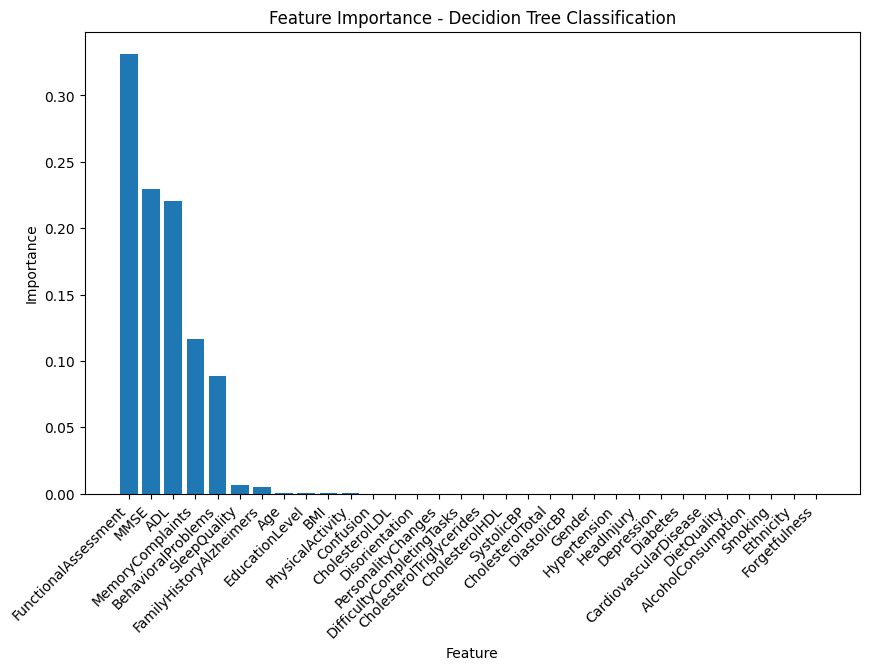

In [58]:
feature_importance_dt = best_model_dt.feature_importances_

feature_importance_dt = pd.DataFrame({'Feature': x_train_almost.columns, 'Importance': feature_importance_dt})

feature_importance_dt = feature_importance_dt.sort_values(by = 'Importance', ascending = False)

plt.figure(figsize = (10, 6))
plt.bar(feature_importance_dt['Feature'], feature_importance_dt['Importance'])
plt.xlabel('Feature')
plt.ylabel('Importance')
plt.title('Feature Importance - Decidion Tree Classification')
plt.xticks(rotation = 45, ha = 'right')
plt.show()

#### SVM

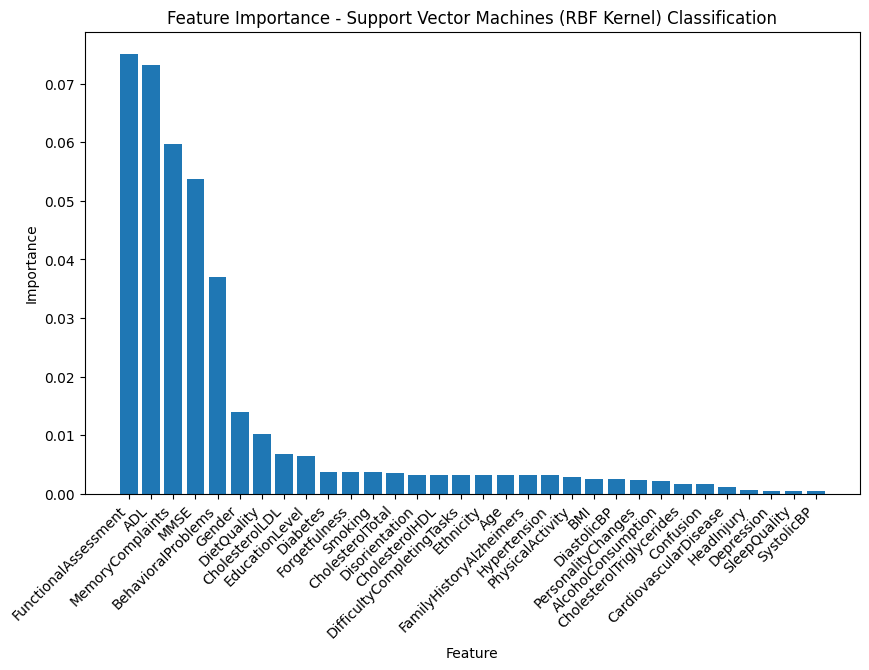

In [59]:
result_svm = permutation_importance(best_model_svm, x_test, y_test, n_repeats = 10, random_state = 42)

feature_importances_svm = np.abs(result_svm.importances_mean)

feature_importance_svm = pd.DataFrame({'Feature': x_train_almost.columns, 'Importance': feature_importances_svm})

feature_importance_svm = feature_importance_svm.sort_values(by = 'Importance', ascending = False)

plt.figure(figsize = (10, 6))
plt.bar(feature_importance_svm['Feature'], feature_importance_svm['Importance'])
plt.xlabel('Feature')
plt.ylabel('Importance')
plt.title('Feature Importance - Support Vector Machines (RBF Kernel) Classification')
plt.xticks(rotation = 45, ha = 'right')
plt.show()

## Extra Study (MAYBEEEEEEEEEE)